# Investigating local SAE features

In [1]:
import torch
import numpy as np
import pandas as pd
import anndata as ad
import multiDGD
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
import math
import os

os.chdir('../..')
os.getcwd()

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [2]:
data = ad.read_h5ad('/projects/heads/data/singlecell/human_bonemarrow.h5ad')

activations = torch.load('03_results/reports/sae_model_10000_l1-1e-3_lr-1e-4_500epochs_activations.pt')

/tmp/ipykernel_1118371/303113056.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  activations = torch.load('03_results/reports/sae_model_10000_l1-1e-3_lr-1e-4_500epochs_a

### save the representation umap

In [3]:
if not os.path.exists("03_results/reports/human_bonemarrow_l20_h2-3_test50e_pca.csv"):
    model = multiDGD.DGD.load(data=data, save_dir="./03_results/models/", model_name="human_bonemarrow_l20_h2-3_test50e")
    reps = model.representation.z.detach()
    data = data[data.obs["train_val_test"] == "train"]

    pca = PCA(n_components=2)
    pca.fit(reps.cpu().numpy())
    # plot the representations
    reps_transformed = pca.transform(reps.cpu().numpy())
    clusters = model.gmm.clustering(torch.tensor(reps)).detach().cpu().numpy()

    df_celltypes = pd.DataFrame(reps_transformed, columns=["PC 1", "PC 2"])
    df_celltypes["type"] = "original"
    df_celltypes["component"] = clusters
    df_celltypes["component"] = df_celltypes["component"].astype(str)
    df_celltypes["celltype"] = data.obs["cell_type"].values
    unique_values = data.obs["cell_type"].cat.categories

    # save the pca
    df_celltypes.to_csv("03_results/reports/human_bonemarrow_l20_h2-3_test50e_pca.csv")
else:
    data = data[data.obs["train_val_test"] == "train"]
    df_celltypes = pd.read_csv("03_results/reports/human_bonemarrow_l20_h2-3_test50e_pca.csv")

### calculate ct-specific activations and determine locality

In [4]:
# go through all cell types and compute each features mean activation and std for ct positive and negative
cell_types = [x for x in data.obs['cell_type'].unique()]
means_positive = torch.zeros((len(cell_types), activations.shape[1]))
se_positive = torch.zeros((len(cell_types), activations.shape[1]))
means_negative = torch.zeros((len(cell_types), activations.shape[1]))
se_negative = torch.zeros((len(cell_types), activations.shape[1]))
for i, ct in enumerate(cell_types):
    data_indices = data.obs['cell_type'] == ct
    activations_pos = activations[data_indices,:]
    activations_neg = activations[~data_indices,:]
    means_positive[i,:] = torch.mean(activations_pos, dim=0).detach().cpu()
    # compute the standard error of the mean
    se_positive[i,:] = torch.std(activations_pos, dim=0).detach().cpu() / math.sqrt(activations_pos.shape[0])
    means_negative[i,:] = torch.mean(activations_neg, dim=0).detach().cpu()
    se_negative[i,:] = torch.std(activations_neg, dim=0).detach().cpu() / math.sqrt(activations_neg.shape[0])
# that gives the "significant features" per cell type
significant_features = torch.BoolTensor((means_positive - means_negative) > 1.96*(se_positive + se_negative))
sum_significant_features = torch.sum(significant_features, dim=0)

###
# unique (local) vs shared (global) features, and there is a thing in the middle which I call regional
###
# all active features
active_features = (torch.where(torch.sum(activations, dim=0) != 0)[0]).tolist()
# local features are the ct specific ones
local_features = (torch.where(sum_significant_features == 1)[0]).tolist()
regional_features = (torch.where(sum_significant_features > 1)[0]).tolist()
# all remaining active features are global
global_features = list(set(active_features).difference(set(local_features).union(set(regional_features))))
print('{} active features, {} local features, {} regional features, {} global features'.format(len(active_features), len(local_features), len(regional_features), len(global_features)))

5318 active features, 908 local features, 1072 regional features, 3338 global features


## Make some plots for different features

## plot function

In [5]:
plt.rcParams.update({'font.size': 15})

In [15]:
def plot_sc_latent_for_feature_withCT(feat_id):
    df_celltypes_temp = df_celltypes.copy()
    df_celltypes_temp["feature"] = activations[:,feat_id].detach().cpu().numpy()
    unique_values = data.obs["cell_type"].cat.categories

    fig, axs = plt.subplots(1, 2, figsize=(8, 6))
    # add space between subplots
    plt.subplots_adjust(wspace=0.5, bottom=0.5, left=0.07)

    # remove the white lines arount the dots
    sns.scatterplot(data=df_celltypes_temp, x="PC 1", y="PC 2", hue="celltype", s=1, alpha=0.7, ec=None, ax=axs[0])
    axs[0].set_title("Representations")
    # change the legend labels so that they show the index of the celltype from the unique_values list
    handles, labels = axs[0].get_legend_handles_labels()
    # put the legend underneat the plot
    axs[0].legend(
        handles,
        [str(np.where(unique_values == label)[0][0]) + " (" + label + ")" for label in labels],
        title="Cell type",
        loc="lower left",
        bbox_to_anchor=(-0.15, -1.3),
        alignment='left',
        markerscale=6,
        fontsize=12,
        ncol=3,
        frameon=False,
        handletextpad=0.2,
        columnspacing=0.8,
    )#.remove()
    # remove the ticks
    axs[0].set_xticks([])
    axs[0].set_yticks([])
    # annotate the plot with the celltype names (on means)
    reps_transformed = df_celltypes[["PC 1", "PC 2"]].values
    for i, celltype in enumerate(unique_values):
        mean = np.mean(reps_transformed[data.obs["cell_type"] == celltype], axis=0)
        # also plot a black dot
        axs[0].scatter(mean[0], mean[1], color='black', s=5)
        axs[0].annotate(i, (mean[0], mean[1]), fontsize=12)

    feat_palette = sns.color_palette('rocket_r', as_cmap=True)
    # the second plot will be the same latent space but colored by the activation of feature 2306
    sns.scatterplot(data=df_celltypes_temp, x="PC 1", y="PC 2", hue='feature', s=1, alpha=0.7, ec=None, ax=axs[1], palette=feat_palette)
    axs[1].set_title("Neuron 2306 activation")
    # remove the ticks
    axs[1].set_xticks([])
    axs[1].set_yticks([])
    # put the leend outside the plot
    cbar_points = plt.scatter([], [], c=[], vmin=df_celltypes_temp['feature'].min(), vmax=df_celltypes_temp['feature'].max(), cmap=feat_palette)
    plt.colorbar(cbar_points, ax=axs[1], label='Activation')
    # remove the normal legend
    axs[1].get_legend().remove()
    plt.tight_layout()

rocket_r_colors = sns.color_palette('rocket_r', n_colors=256)
def plot_feature_grid(feat_ids, ct_name):
    if len(feat_ids) > 23:
        print("Too many features to plot")
        print("Only plotting the 23 most significant")
        feat_ids = feat_ids[:23]
    n = len(feat_ids)
    n_cols = min((n+1), 4)
    n_rows = math.ceil((n+1) / n_cols)
    fig, axs = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 4*n_rows))
    # first plot is to show where the celltype is
    df_celltypes_temp = df_celltypes.copy()
    df_celltypes_temp[ct_name] = 0
    df_celltypes_temp.loc[data.obs["cell_type"].values == ct_name, ct_name] = 1
    # "zoom in" to the pca of the cell type
    # get min-max x and y values for the cell type
    x_min = df_celltypes_temp.loc[df_celltypes_temp[ct_name] == 1, "PC 1"].min()
    x_max = df_celltypes_temp.loc[df_celltypes_temp[ct_name] == 1, "PC 1"].max()
    y_min = df_celltypes_temp.loc[df_celltypes_temp[ct_name] == 1, "PC 2"].min()
    y_max = df_celltypes_temp.loc[df_celltypes_temp[ct_name] == 1, "PC 2"].max()
    df_celltypes_temp = df_celltypes_temp.sort_values(by=ct_name, ascending=True)
    if n_rows == 1:
        sns.scatterplot(data=df_celltypes_temp, x="PC 1", y="PC 2", hue=ct_name, s=2, alpha=0.7, ec=None, ax=axs[0], palette=[rocket_r_colors[0], rocket_r_colors[-1]])
        cbar_points = plt.scatter([], [], c=[], vmin=df_celltypes_temp[ct_name].min(), vmax=df_celltypes_temp[ct_name].max(), cmap='rocket_r')
        plt.colorbar(cbar_points, ax=axs[0], label=ct_name)
        axs[0].set_xlim(x_min, x_max)
        axs[0].set_ylim(y_min, y_max)
        axs[0].set_title(f"{ct_name} location")
        axs[0].get_legend().remove()
    else:
        sns.scatterplot(data=df_celltypes_temp, x="PC 1", y="PC 2", hue=ct_name, s=2, alpha=0.7, ec=None, ax=axs[0, 0], palette=[rocket_r_colors[0], rocket_r_colors[-1]])
        cbar_points = plt.scatter([], [], c=[], vmin=df_celltypes_temp[ct_name].min(), vmax=df_celltypes_temp[ct_name].max(), cmap='rocket_r')
        plt.colorbar(cbar_points, ax=axs[0, 0], label=ct_name)
        axs[0, 0].set_xlim(x_min, x_max)
        axs[0, 0].set_ylim(y_min, y_max)
        axs[0, 0].set_title(f"{ct_name} location")
        axs[0, 0].get_legend().remove()
    for i, feat_id in enumerate(feat_ids):
        row = (i+1) // n_cols
        col = (i+1) % n_cols
        df_celltypes_temp = df_celltypes.copy()
        df_celltypes_temp["feature"] = activations[:,feat_id].detach().cpu().numpy()
        # sort by the feature activation
        df_celltypes_temp = df_celltypes_temp.sort_values(by='feature', ascending=True)
        #sns.scatterplot(data=df_celltypes_temp, x="PC 1", y="PC 2", hue='feature', size='feature', s=1, alpha=0.7, ec=None, ax=axs[row, col], palette='rocket_r')
        if n_rows == 1:
            sns.scatterplot(data=df_celltypes_temp, x="PC 1", y="PC 2", hue='feature', size='feature', s=1, alpha=0.7, ec=None, ax=axs[col], palette='rocket_r', sizes=(2,20))
            axs[col].set_title(f"Feature {feat_id}")
            # remove the ticks
            axs[col].set_xticks([])
            axs[col].set_yticks([])
            # set limits
            axs[col].set_xlim(x_min, x_max)
            axs[col].set_ylim(y_min, y_max)
            # put the leend outside the plot
            cbar_points = plt.scatter([], [], c=[], vmin=df_celltypes_temp['feature'].min(), vmax=df_celltypes_temp['feature'].max(), cmap='rocket_r')
            plt.colorbar(cbar_points, ax=axs[col], label='Activation')
            # remove the normal legend
            axs[col].get_legend().remove()
        else:
            sns.scatterplot(data=df_celltypes_temp, x="PC 1", y="PC 2", hue='feature', size='feature', s=1, alpha=0.7, ec=None, ax=axs[row, col], palette='rocket_r', sizes=(2,20))
            axs[row, col].set_title(f"Feature {feat_id}")
            # remove the ticks
            axs[row, col].set_xticks([])
            axs[row, col].set_yticks([])
            # set limits
            axs[row, col].set_xlim(x_min, x_max)
            axs[row, col].set_ylim(y_min, y_max)
            # put the leend outside the plot
            cbar_points = plt.scatter([], [], c=[], vmin=df_celltypes_temp['feature'].min(), vmax=df_celltypes_temp['feature'].max(), cmap='rocket_r')
            plt.colorbar(cbar_points, ax=axs[row, col], label='Activation')
            # remove the normal legend
            axs[row, col].get_legend().remove()
    plt.tight_layout()

def plot_latent_ct():
    unique_values = data.obs["cell_type"].cat.categories
    fig, axs = plt.subplots(1, 1, figsize=(12, 8))
    # add space between subplots
    plt.subplots_adjust(wspace=0.5, bottom=0.5, left=0.07)

    # remove the white lines arount the dots
    sns.scatterplot(data=df_celltypes, x="PC 1", y="PC 2", hue="celltype", s=1, alpha=0.7, ec=None)
    plt.title("Representations")
    # change the legend labels so that they show the index of the celltype from the unique_values list
    handles, labels = axs.get_legend_handles_labels()
    # put the legend underneat the plot
    plt.legend(
        handles,
        [str(np.where(unique_values == label)[0][0]) + " (" + label + ")" for label in labels],
        title="Cell type",
        loc="upper right",
        bbox_to_anchor=(1.5, 1.2),
        alignment='left',
        markerscale=6,
        fontsize=12,
        ncol=1,
        frameon=False,
        handletextpad=0.2,
        columnspacing=0.8,
    )#.remove()
    # remove the ticks
    plt.xticks([])
    plt.yticks([])
    # annotate the plot with the celltype names (on means)
    reps_transformed = df_celltypes[["PC 1", "PC 2"]].values
    for i, celltype in enumerate(unique_values):
        mean = np.mean(reps_transformed[data.obs["cell_type"] == celltype], axis=0)
        # also plot a black dot
        plt.scatter(mean[0], mean[1], color='black', s=5)
        plt.annotate(i, (mean[0], mean[1]), fontsize=12)
    
    plt.tight_layout()

## trying local features

In [6]:
len(local_features)

1628

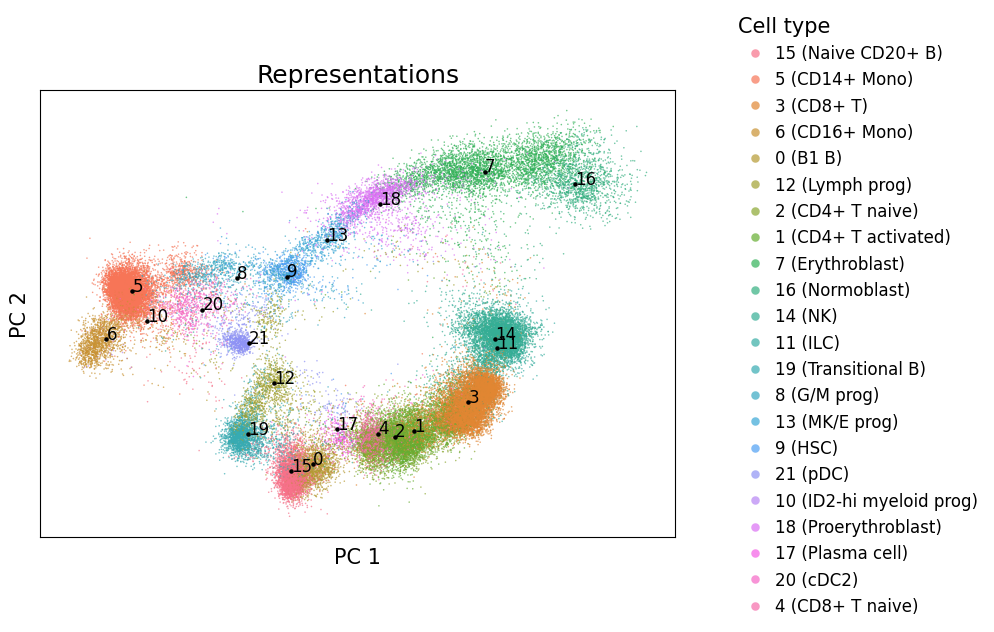

In [62]:
plot_latent_ct()

In [ ]:
# go through them by celltype

unique_ct_features = {}
unique_ct_feature_indices = torch.where(sum_significant_features == 1)[0]
for i, ct in enumerate(cell_types):
    ct_features_temp = torch.where(significant_features[i,:])[0]
    # get the intersection with the unique features
    intersect_feats = list(set(list(ct_features_temp.numpy())).intersection(set(list(unique_ct_feature_indices.numpy()))))
    unique_ct_features[ct] = intersect_feats
    print('Cell type: {}, # unique features: {}'.format(ct, len(intersect_feats)))

Cell type: Naive CD20+ B, # unique features: 15
Cell type: CD14+ Mono, # unique features: 118
Cell type: CD8+ T, # unique features: 12
Cell type: CD16+ Mono, # unique features: 128
Cell type: B1 B, # unique features: 35
Cell type: Lymph prog, # unique features: 23
Cell type: CD4+ T naive, # unique features: 13
Cell type: CD4+ T activated, # unique features: 11
Cell type: Erythroblast, # unique features: 123
Cell type: Normoblast, # unique features: 141
Cell type: NK, # unique features: 4
Cell type: ILC, # unique features: 19
Cell type: Transitional B, # unique features: 25
Cell type: G/M prog, # unique features: 31
Cell type: MK/E prog, # unique features: 0
Cell type: HSC, # unique features: 21
Cell type: pDC, # unique features: 19
Cell type: ID2-hi myeloid prog, # unique features: 28
Cell type: Proerythroblast, # unique features: 104
Cell type: Plasma cell, # unique features: 8
Cell type: cDC2, # unique features: 28
Cell type: CD8+ T naive, # unique features: 2


### B cells

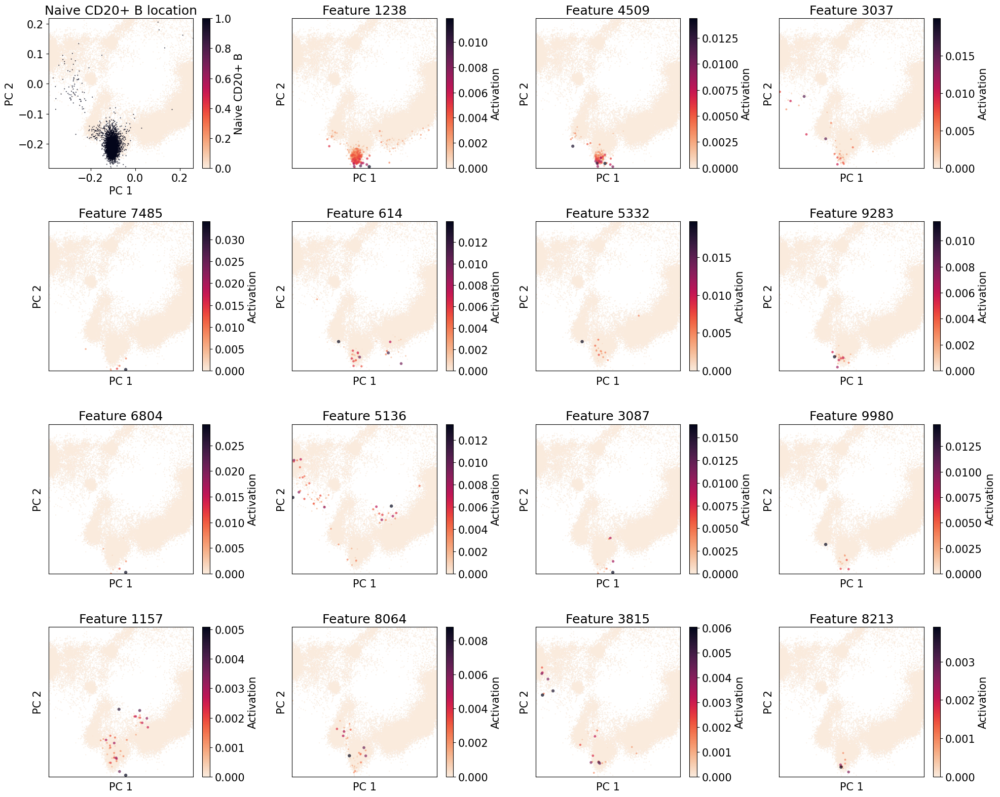

In [16]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'Naive CD20+ B'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

Too many features to plot
Only plotting the 23 most significant


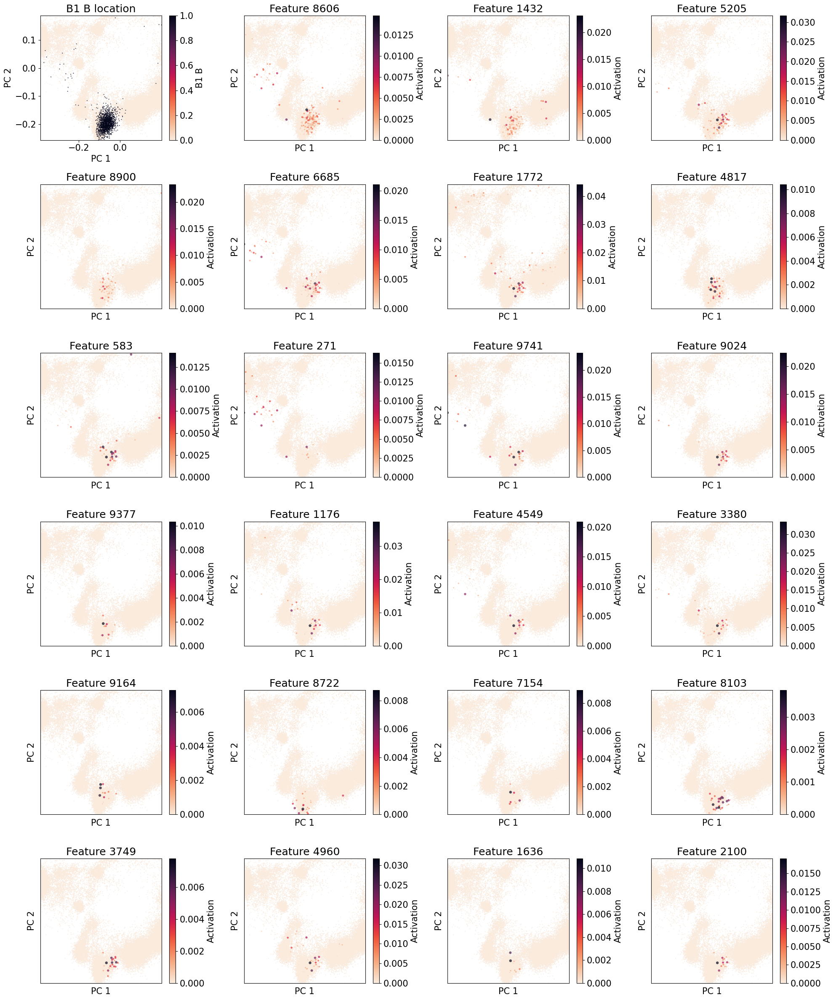

In [17]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'B1 B'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

Too many features to plot
Only plotting the 23 most significant


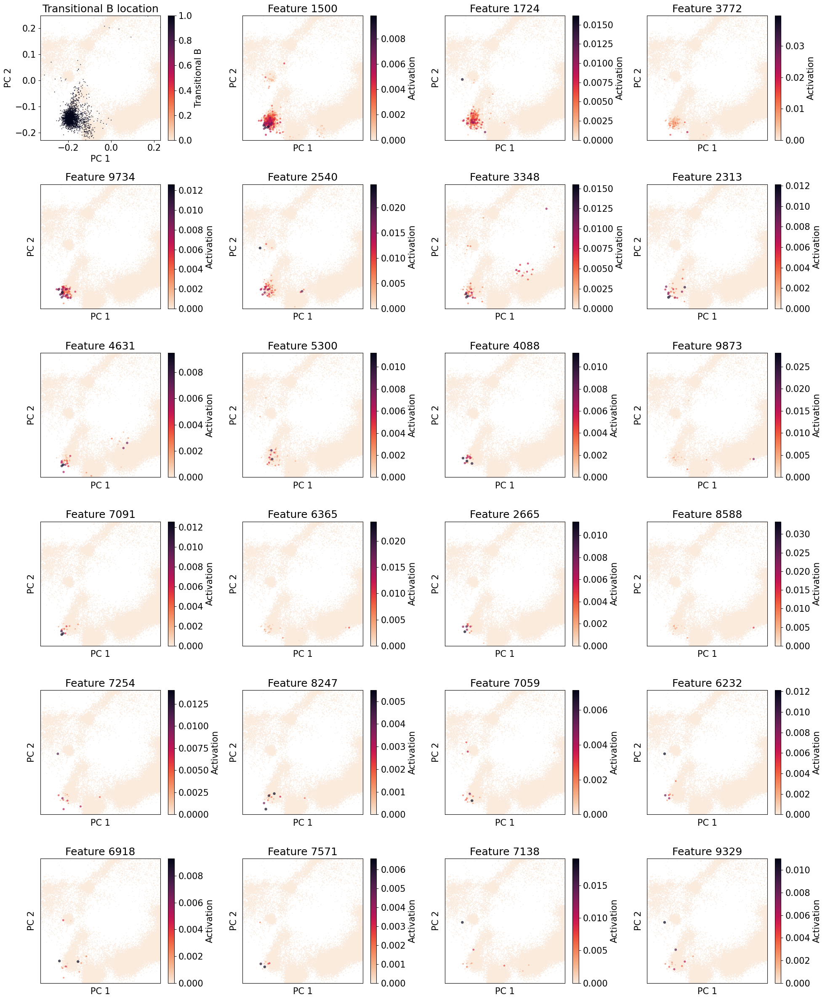

In [18]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'Transitional B'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

### Monocytes

Too many features to plot
Only plotting the 23 most significant


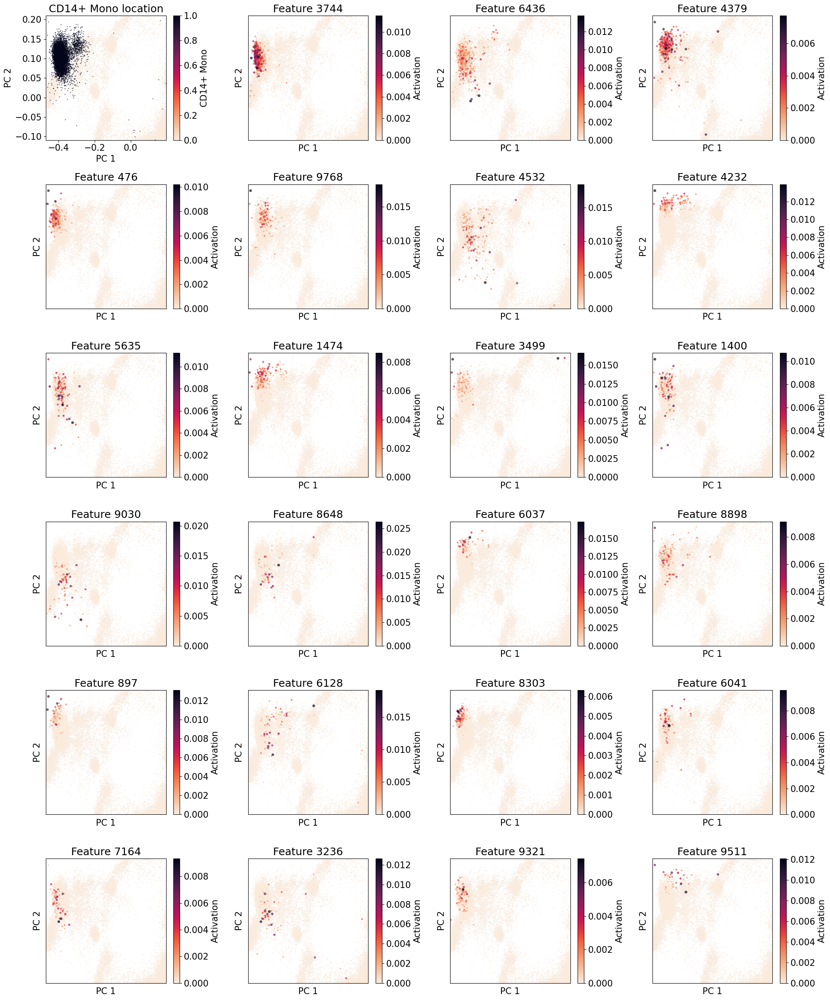

In [19]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'CD14+ Mono'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

Too many features to plot
Only plotting the 23 most significant


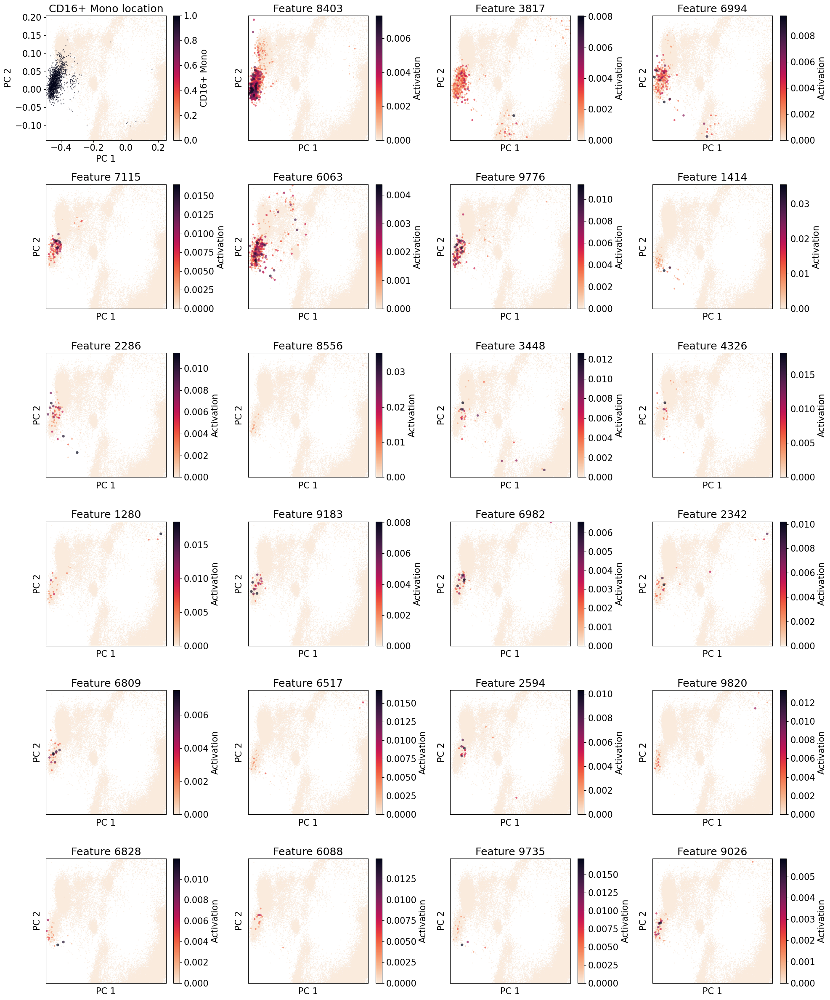

In [20]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'CD16+ Mono'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

### Immune cells

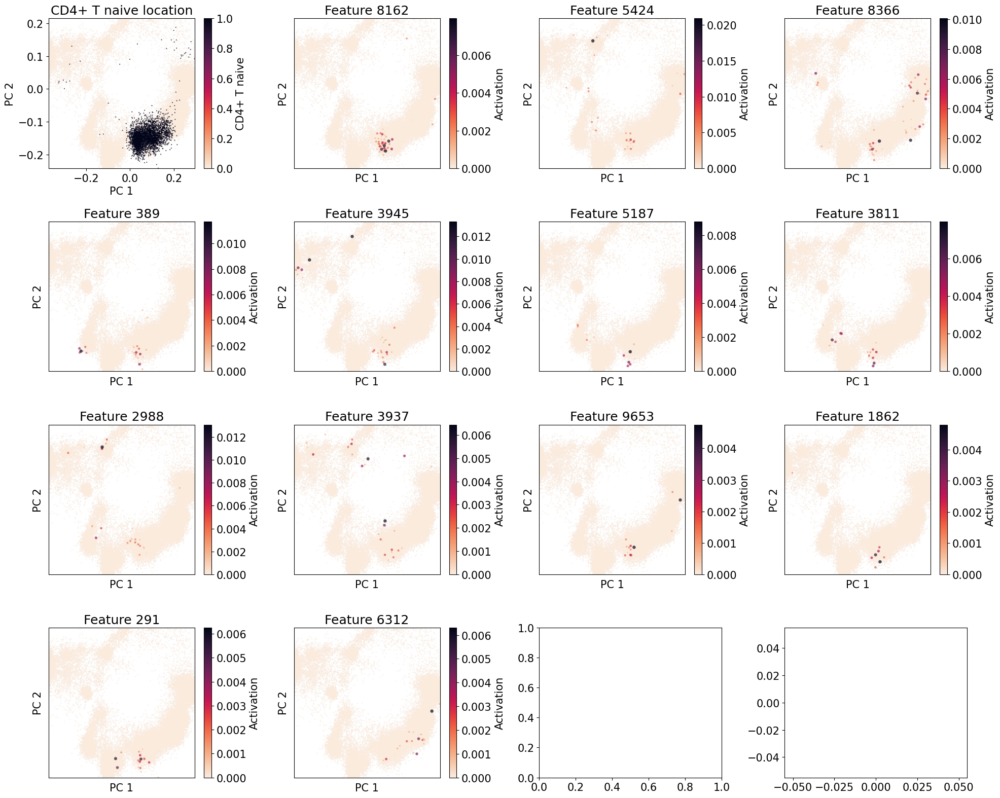

In [21]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'CD4+ T naive'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

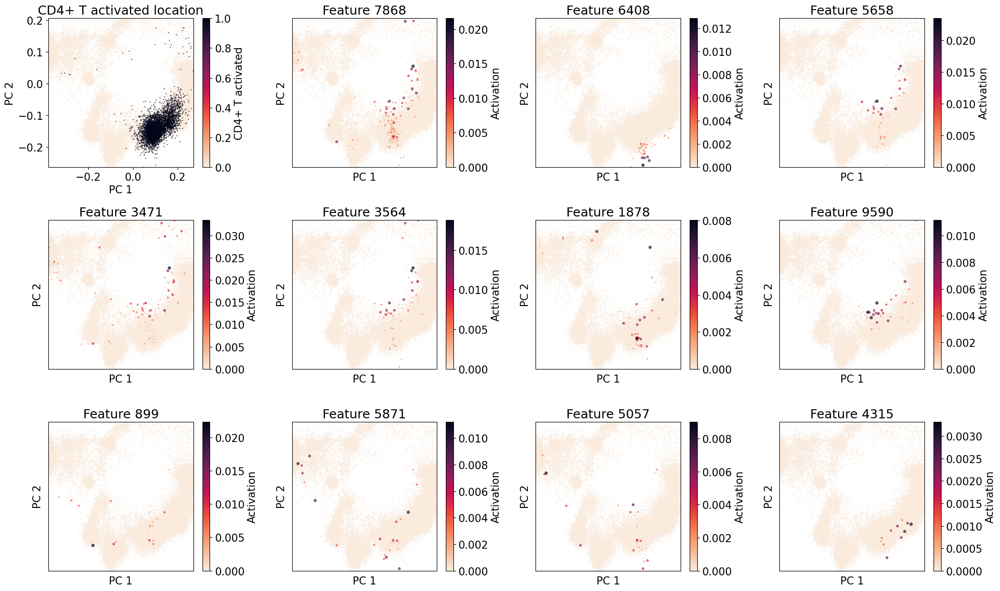

In [22]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'CD4+ T activated'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

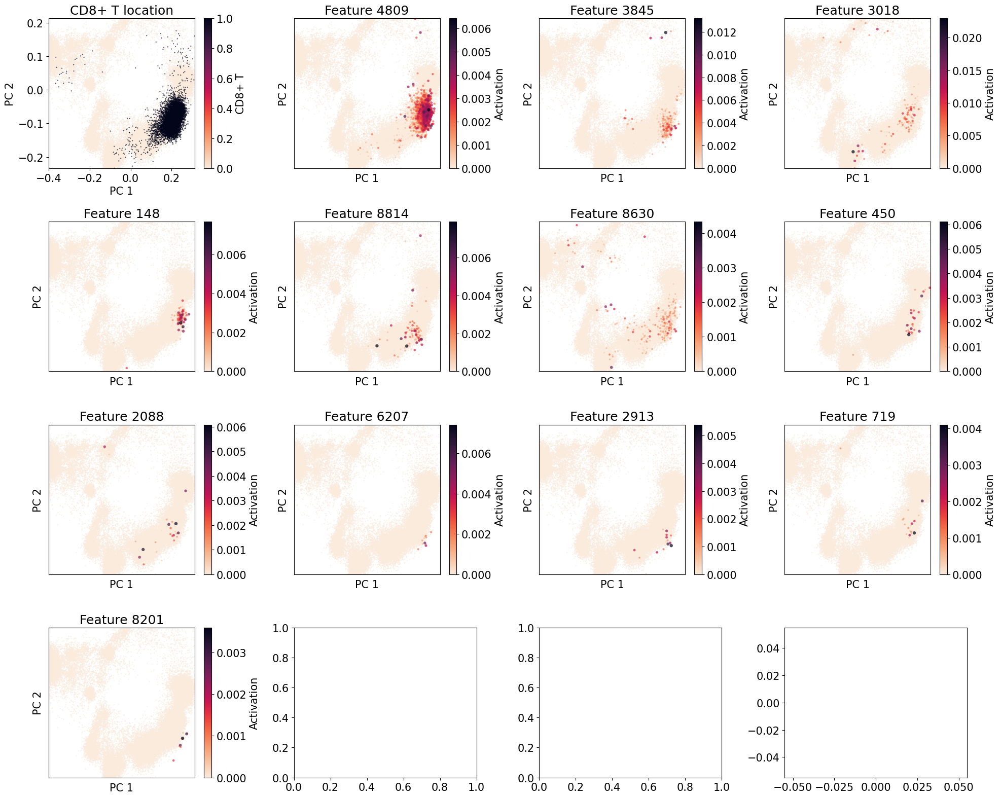

In [23]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'CD8+ T'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

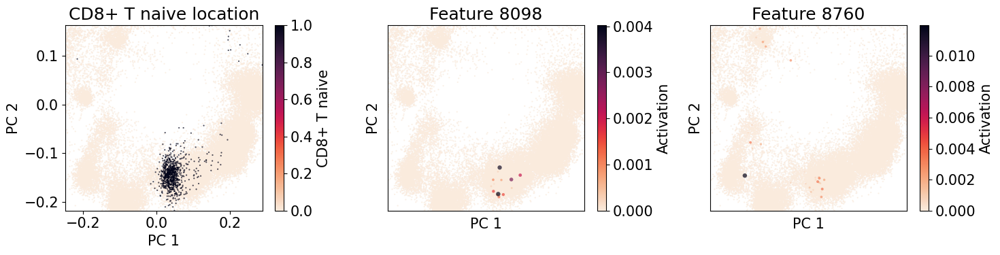

In [24]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'CD8+ T naive'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

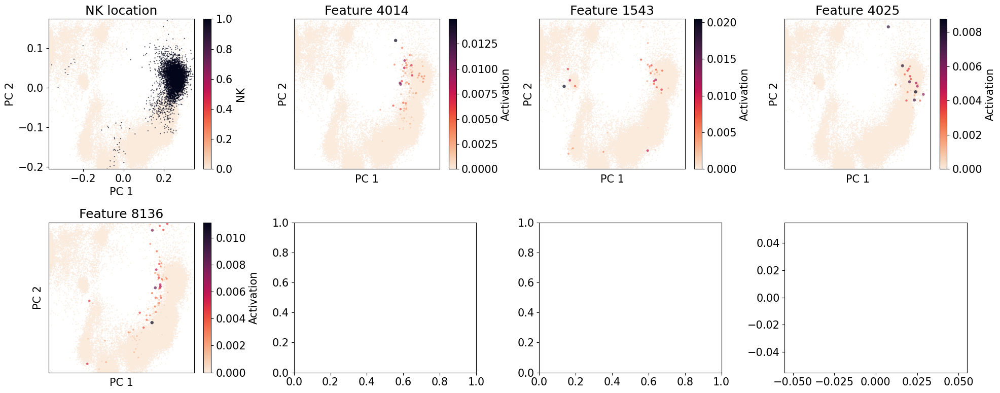

In [25]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'NK'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

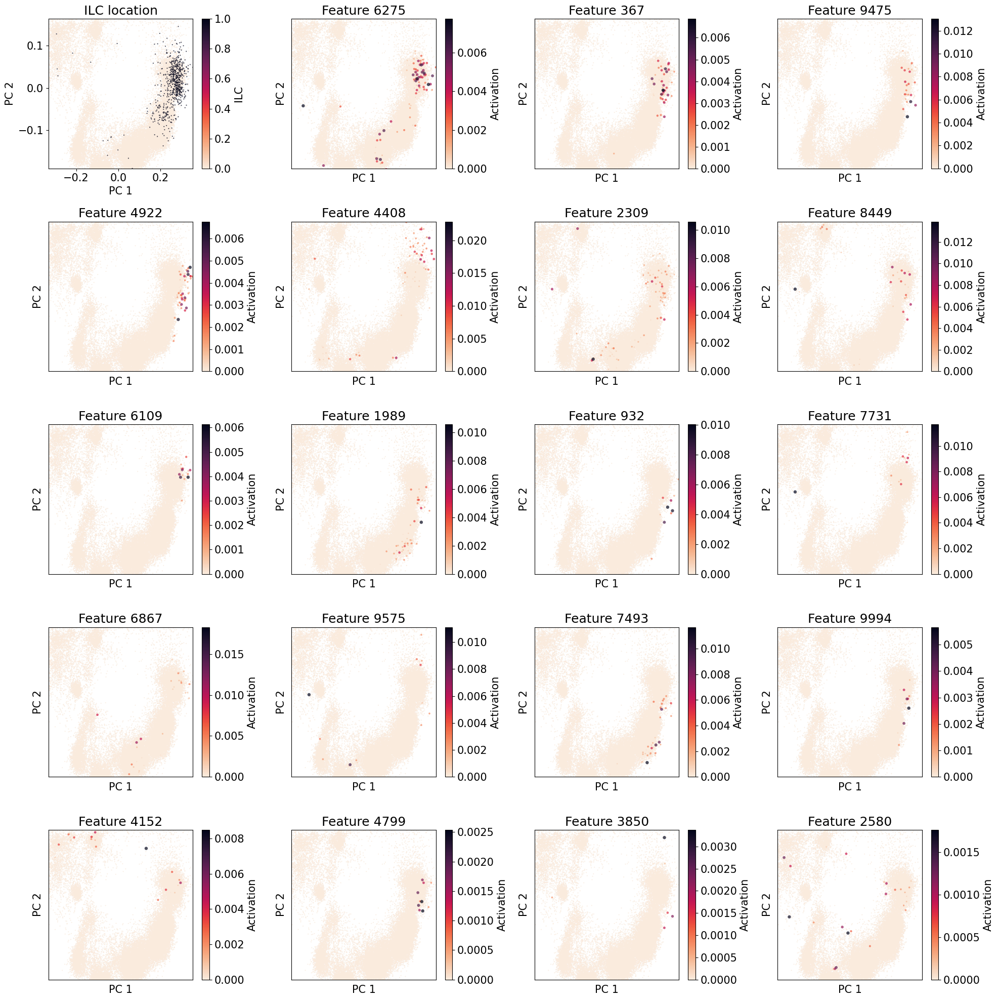

In [28]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'ILC'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

### Progenitors and stem cells

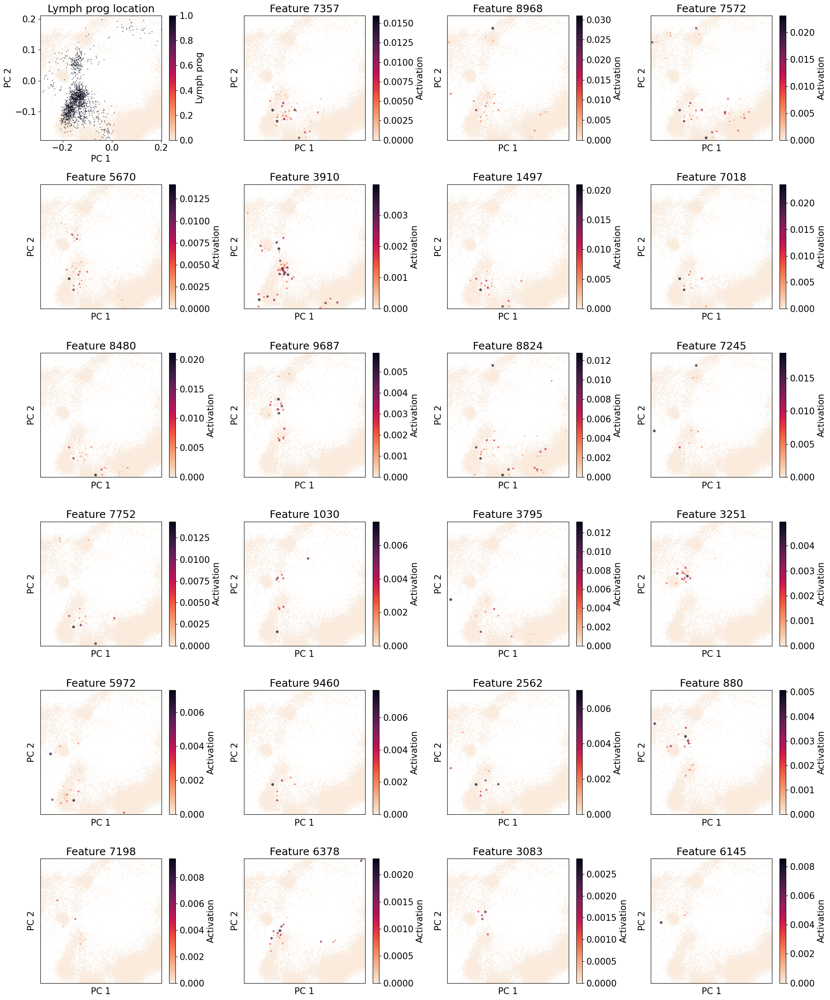

In [29]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'Lymph prog'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

Too many features to plot
Only plotting the 23 most significant


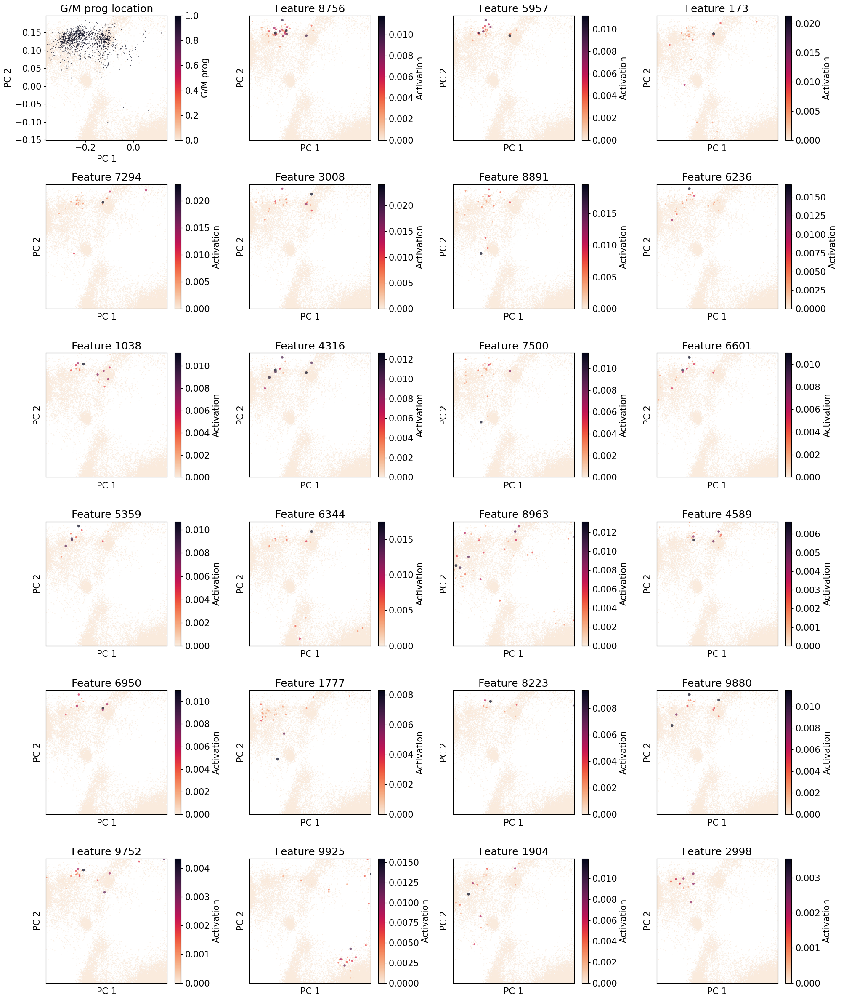

In [30]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'G/M prog'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

In [32]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'MK/E prog'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

#plot_feature_grid(sorted_features, ct_of_interest) # MK/E have none

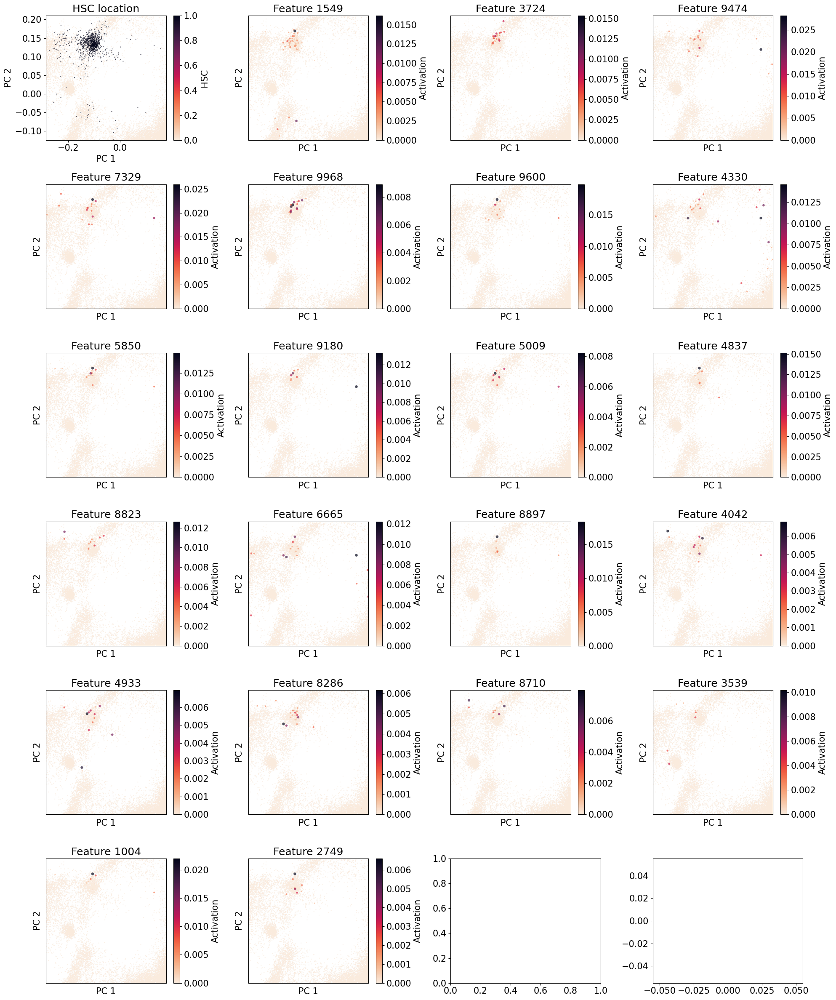

In [33]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'HSC'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

Too many features to plot
Only plotting the 23 most significant


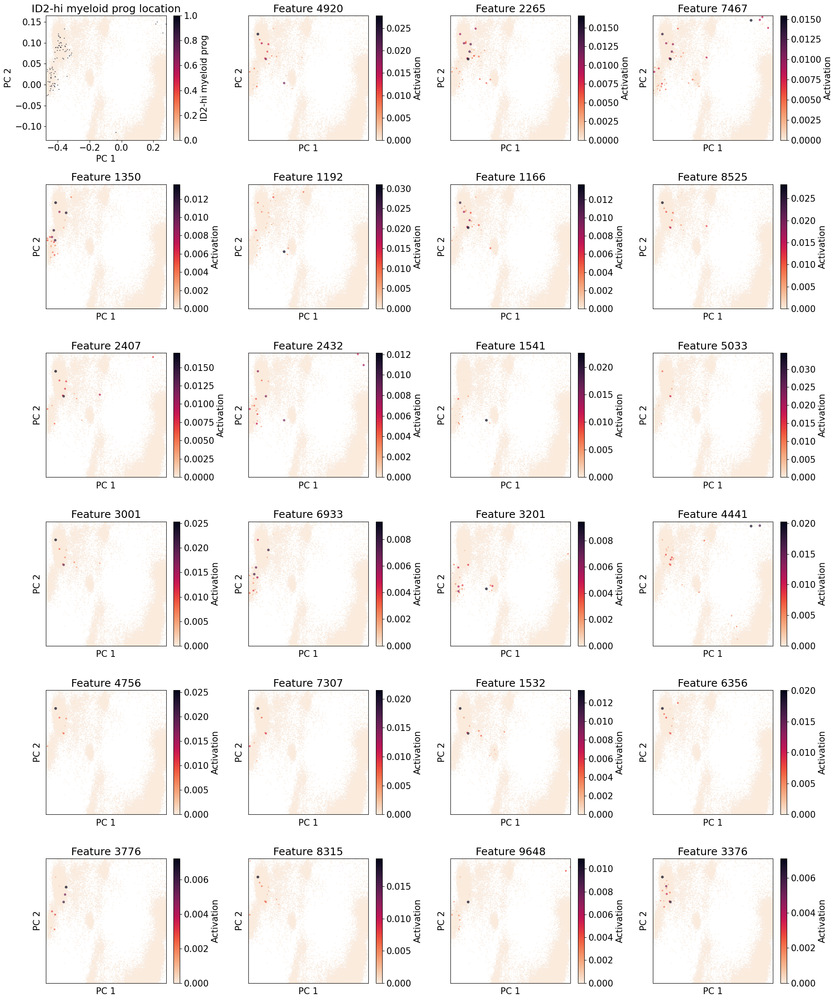

In [34]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'ID2-hi myeloid prog'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

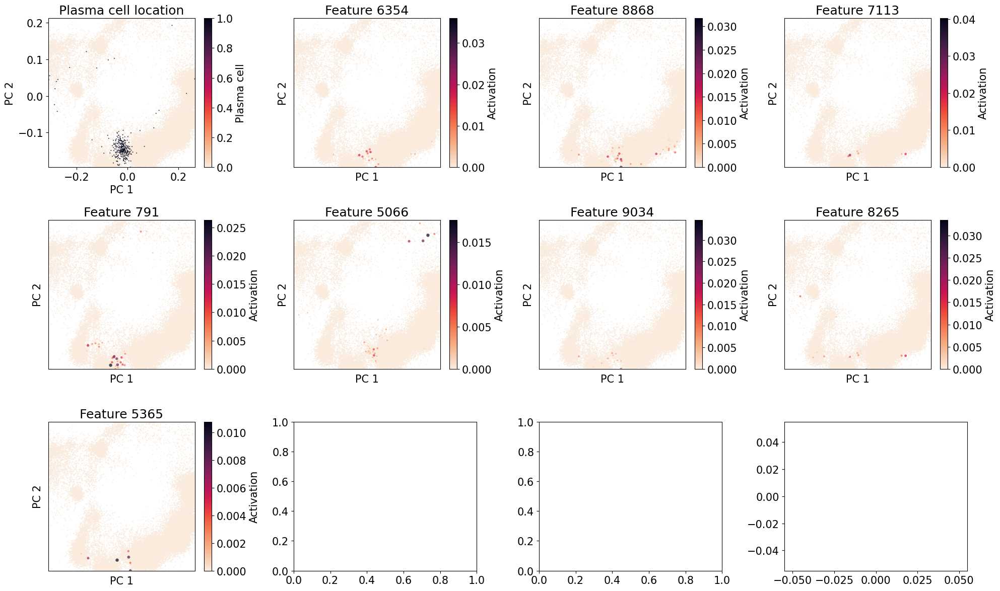

In [35]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'Plasma cell'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

### blasts

Too many features to plot
Only plotting the 23 most significant


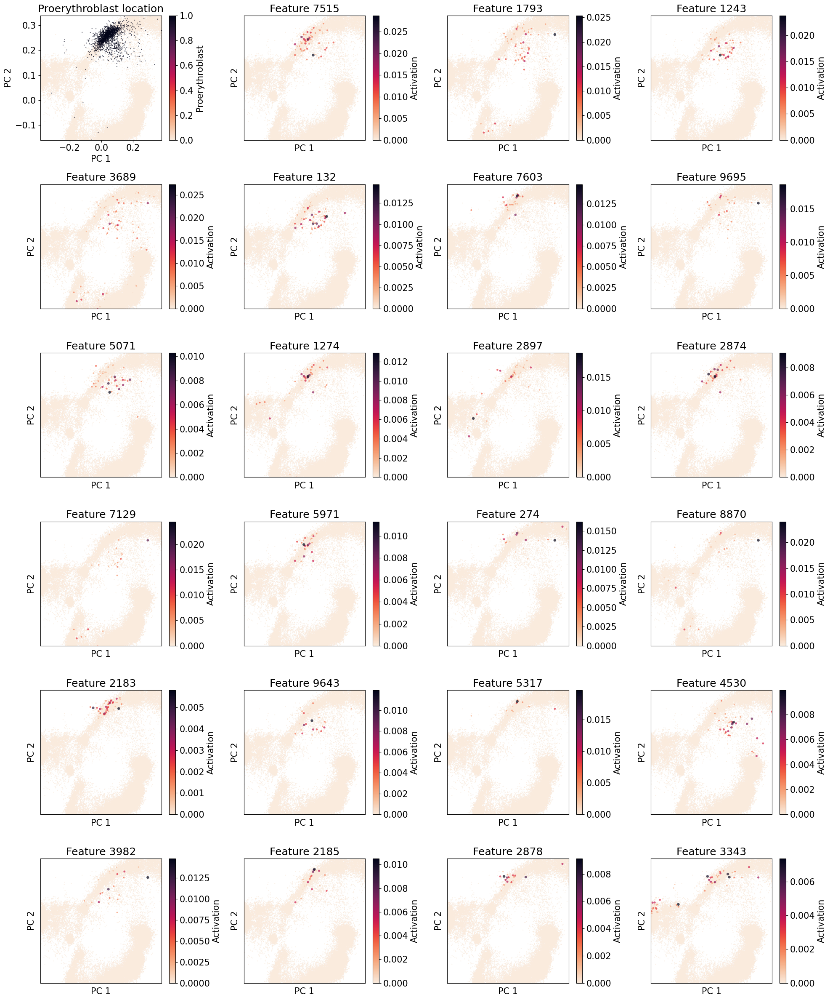

In [36]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'Proerythroblast'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

Too many features to plot
Only plotting the 23 most significant


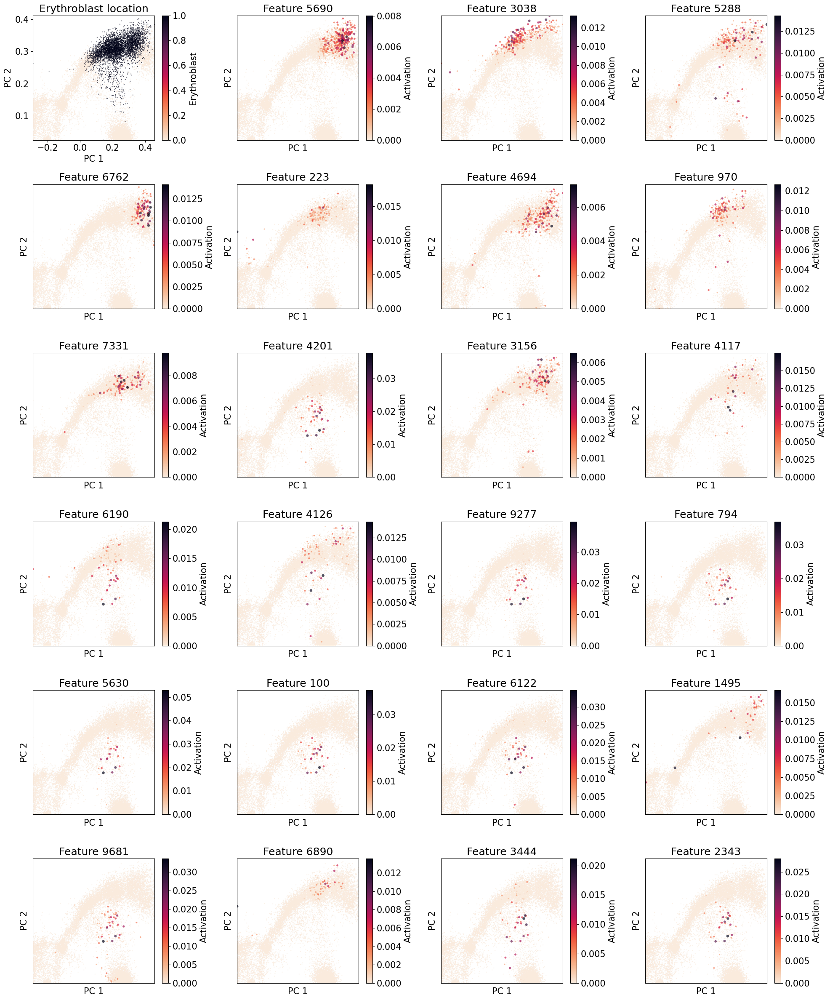

In [37]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'Erythroblast'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

Too many features to plot
Only plotting the 23 most significant


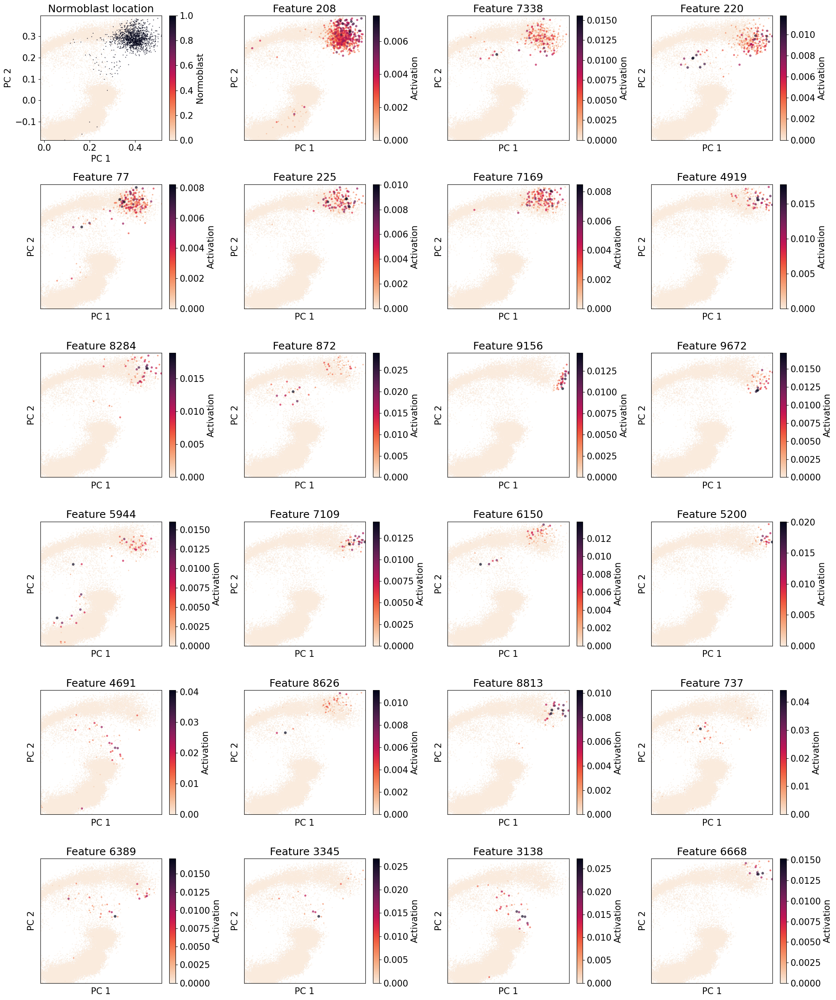

In [38]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'Normoblast'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

### Dendritic cells

Feature 6401: 0.00011809861462097615 (signif), 0.0001376208965666592 (ct), 7.577503311040346e-06 (other)
Feature 4616: 9.746001160237938e-05 (signif), 0.00010732150985859334 (ct), 1.661505052652501e-06 (other)
Feature 20: 8.024321869015694e-05 (signif), 0.00010663779539754614 (ct), 1.4894853848090861e-05 (other)
Feature 3229: 8.854451880324632e-05 (signif), 0.00010163735714741051 (ct), 4.467465714697028e-06 (other)
Feature 1442: 0.0002809037687256932 (signif), 0.00031966279493644834 (ct), 1.6281041098409332e-05 (other)
Feature 8484: 8.779703784966841e-05 (signif), 9.976656292565167e-05 (ct), 2.960079882541322e-06 (other)
Feature 6181: 2.559422136982903e-05 (signif), 3.503305561025627e-05 (ct), 3.992398433183553e-06 (other)
Feature 9645: 6.880082219140604e-05 (signif), 8.143619925249368e-05 (ct), 5.099750524095725e-06 (other)
Feature 6191: 5.662899638991803e-05 (signif), 6.566671800101176e-05 (ct), 3.5981911423732527e-06 (other)
Feature 8115: 0.00012032908853143454 (signif), 0.000148752

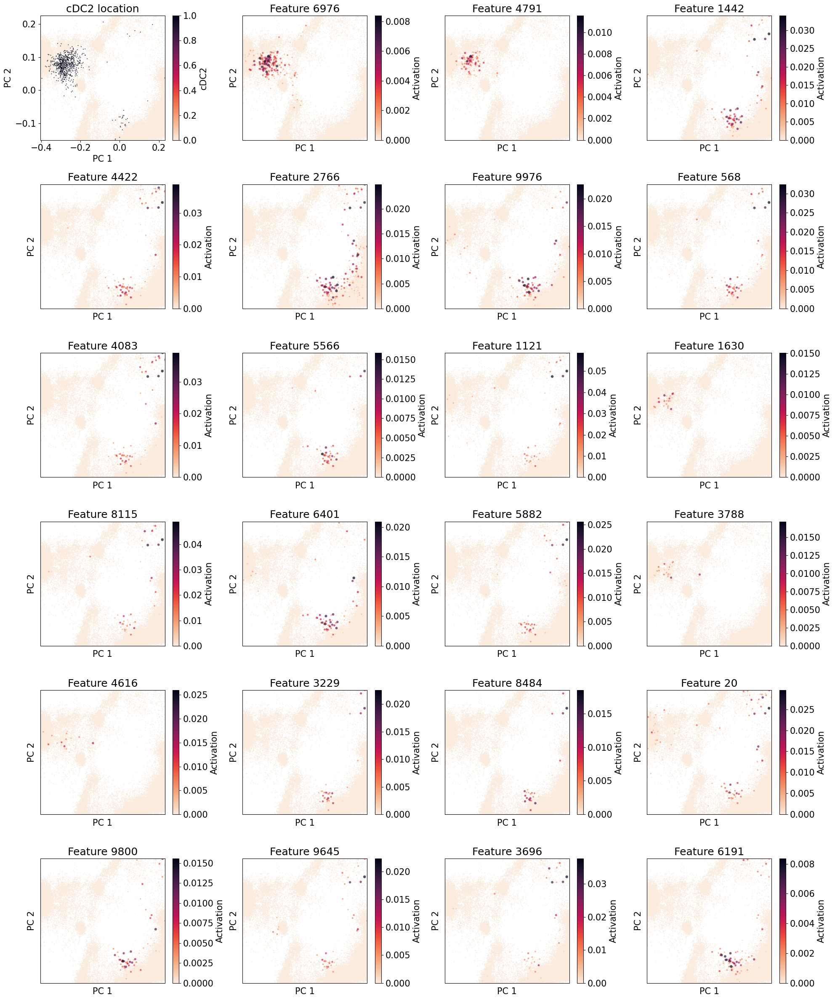

In [40]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'cDC2'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)

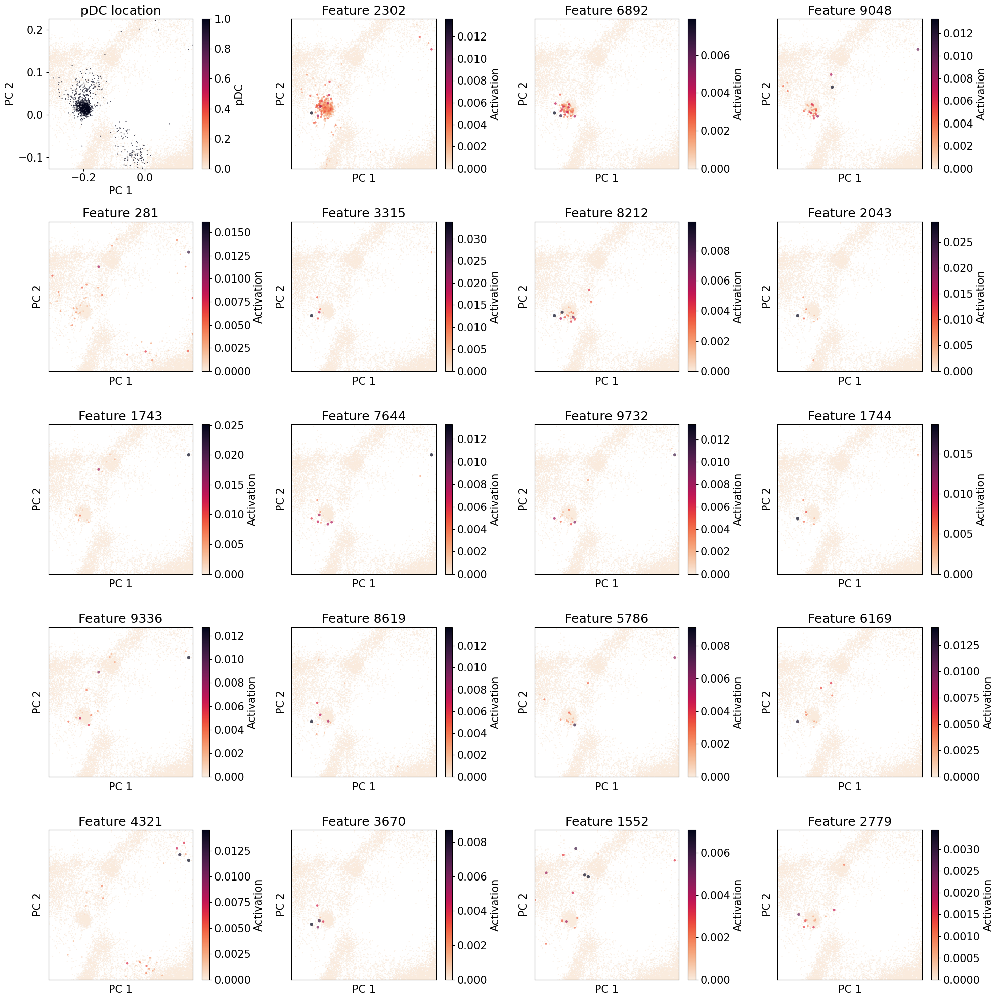

In [41]:
# calculate the mean activation of the unique features for each cell type (in ct and in all others)
ct_of_interest = 'pDC'
feature_significance = []

for feat in unique_ct_features[ct_of_interest]:
    feat_activations = activations[:,feat]
    ct_indices = data.obs['cell_type'] == ct_of_interest
    ct_mean = torch.mean(feat_activations[ct_indices])
    ct_se = torch.std(feat_activations[ct_indices]) / math.sqrt(len(ct_indices))
    other_mean = torch.mean(feat_activations[~ct_indices])
    other_se = torch.std(feat_activations[~ct_indices]) / math.sqrt(len(~ct_indices))
    mean_diff = ct_mean - other_mean
    total_se = ct_se + other_se
    significance = mean_diff - 1.96*total_se
    feature_significance.append(significance)
    #print(f'Feature {feat}: {significance} (signif), {ct_mean} (ct), {other_mean} (other)')

# now sort the features by significance
sorted_features = [x for _, x in sorted(zip(feature_significance, unique_ct_features[ct_of_interest]), reverse=True)]

plot_feature_grid(sorted_features, ct_of_interest)